## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

In [2]:
#imports
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
%matplotlib inline

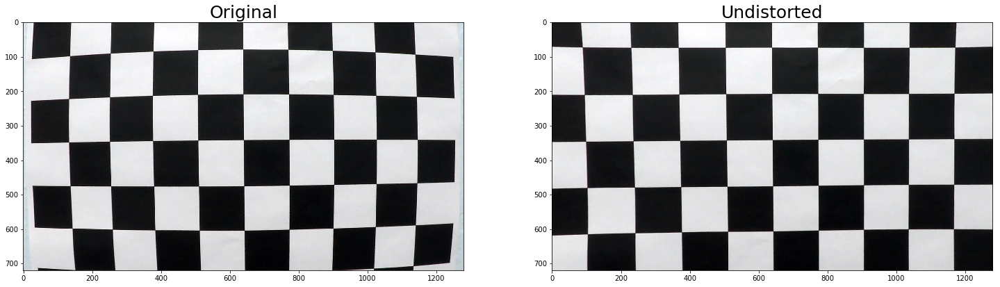

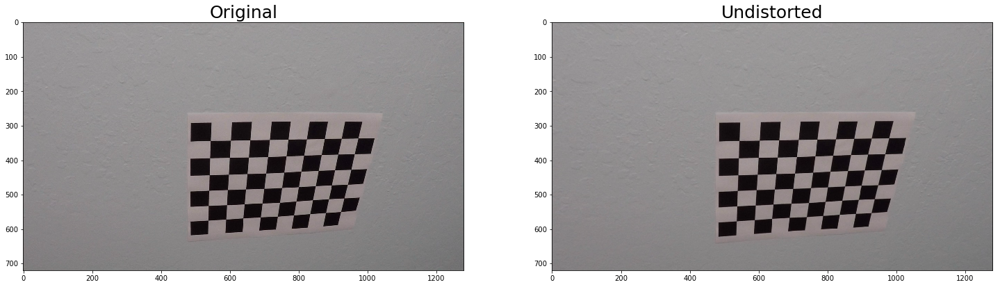

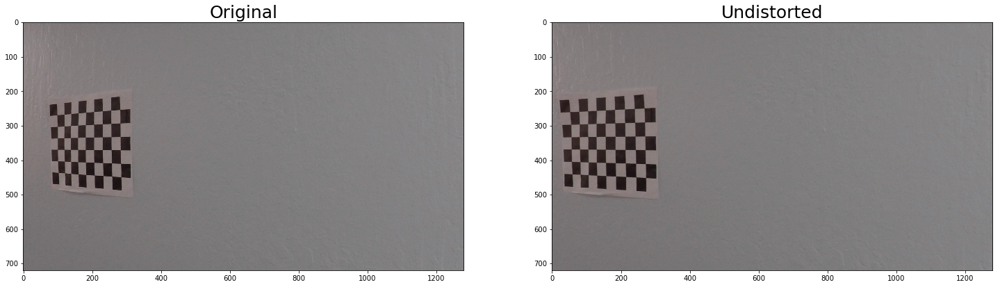

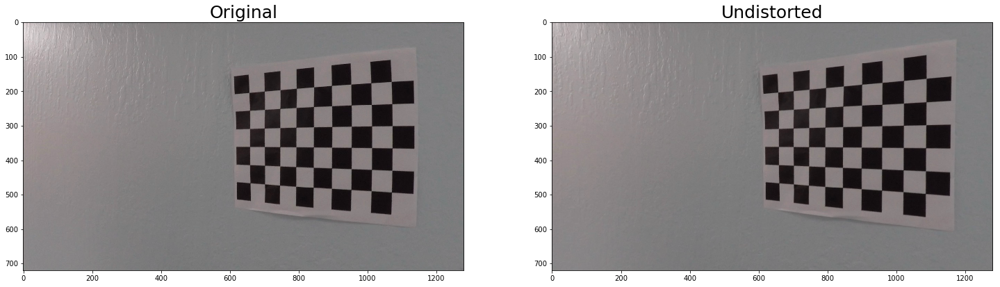

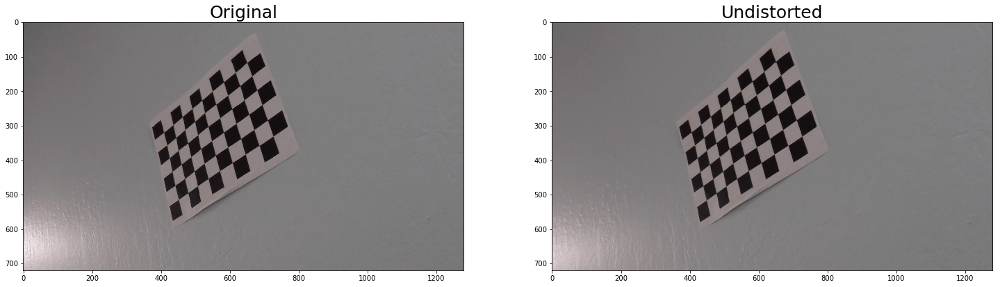

...

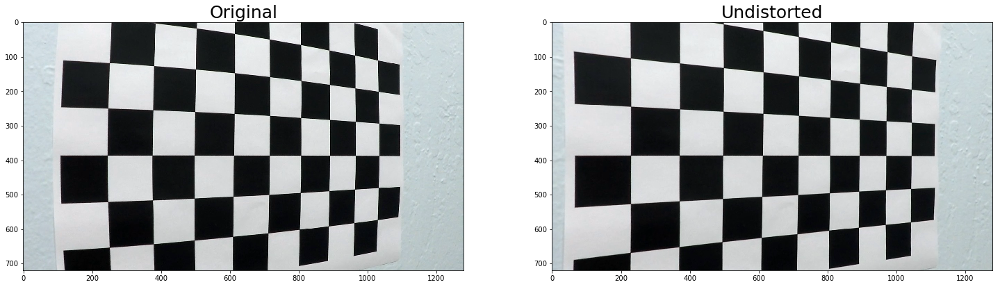

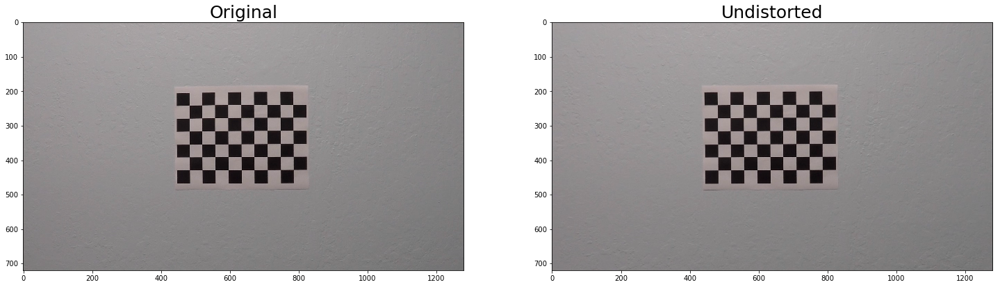

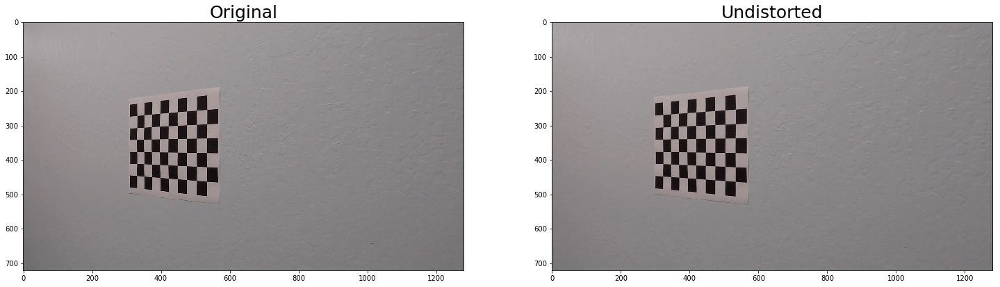

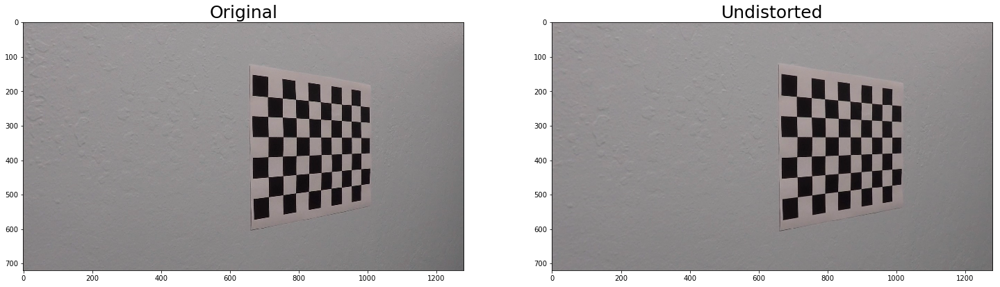

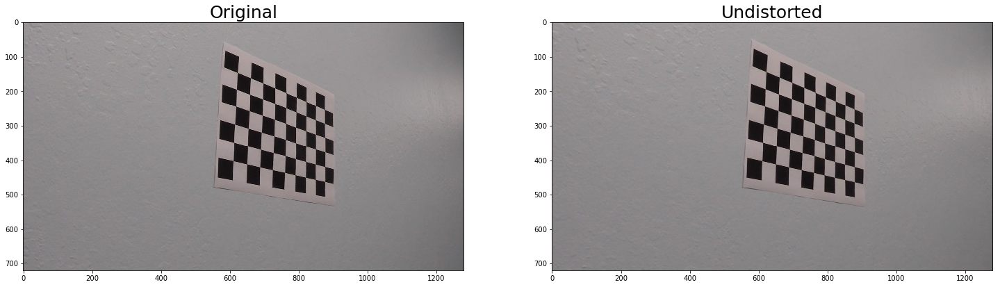

In [301]:
# In this cell I calculate the camera calibration.
# Each calibration image is displayed to verify.

chessboard_columns = 9
chessboard_rows = 6


# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((chessboard_rows * chessboard_columns, 3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    return undist


def camera_calibration_data(grayscale_sample_image, objpoints, imgpoints):
    _ret, mtx, dist, _rvecs, _tvecs = cv2.calibrateCamera(
        objpoints,
        imgpoints,
        grayscale_sample_image.shape[::-1],
        None,
        None
    )
    
    return mtx, dist
        

# Step through the list of calibration images and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (chessboard_columns, chessboard_rows), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

# get calibration matrix based on all calibration images
calibration_mtx, calibration_dist = camera_calibration_data(gray, objpoints, imgpoints)

# show calibration images with undistortion applied
for fname in images:
    img = cv2.imread(fname)
    undistorted = undistort(img, calibration_mtx, calibration_dist)
    figure = plt.figure(fname)
    
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted', fontsize=25)

In [731]:
# convert RGB image to three new channels,
# reflecting a thresholded X gradient in the S and L channels,
# plus a thresholded S channel
def extract_features(img, s_thresh=(170, 255), sx_thresh=(40, 100)):
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(np.copy(img), cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    
    # Sobel x in L
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    
    # Threshold x gradient in L
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Sobel x in S
    S_sobelx = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    S_abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    S_scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    S_sxbinary = np.zeros_like(S_scaled_sobel)
    S_sxbinary[(S_scaled_sobel >= sx_thresh[0]) & (S_scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack sobel x in L, sobel x in S, and thresholded x
    color_binary = np.dstack((S_sxbinary, sxbinary, s_binary))
    
    gray_binary = np.zeros_like(scaled_sobel)
    gray_binary[(S_sxbinary == 1) | (sxbinary == 1) | (s_binary == 1)] = 1
    
    return color_binary, gray_binary

def mask_away_noise(img):

    """
    Removes the portion of the image unlikely to contain relevant lines
    """
    width = img.shape[1]
    height = img.shape[0]
    
    for y in range(height):
        for x in range(width):
            in_top_of_image = y < height * 0.6
            
            in_left_triangle = y < (height / -width) * 0.85 * x + height
            in_right_triangle = y < (height / width) * 0.85 * x + (height * (1 - 0.85))
            
            between_lanes = False
            if y > 0.7 * height:
                x_range = y - (0.7 * height)
                x_range *= 1.2
                if x > (width / 2) - x_range and x < (width / 2) + x_range:
                    between_lanes = True
            
            if in_top_of_image or in_left_triangle or in_right_triangle or between_lanes:
                img[y, x] = 0
    
    return img

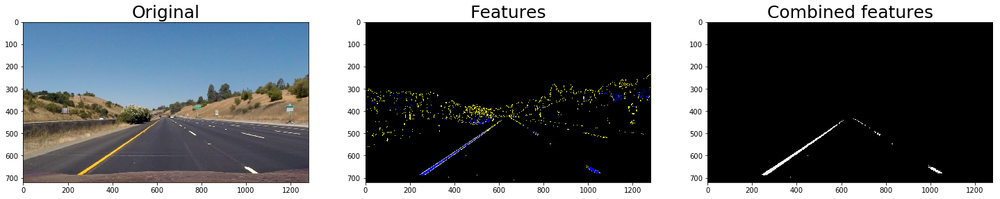

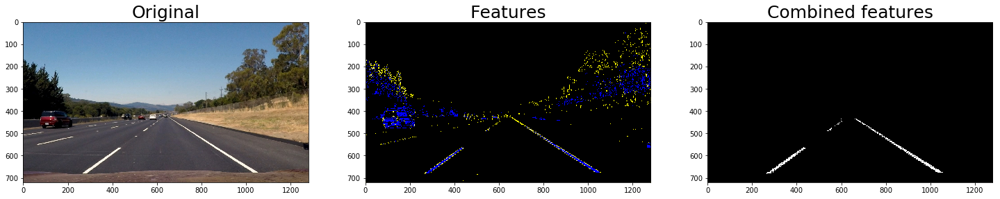

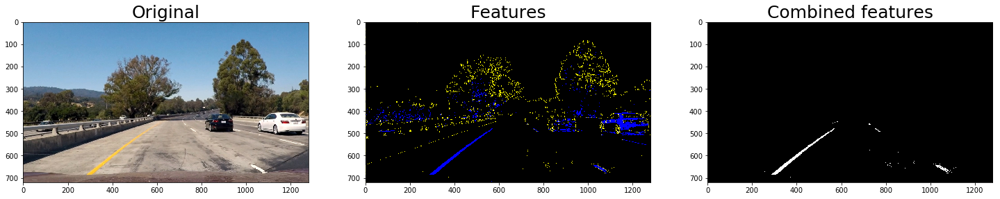

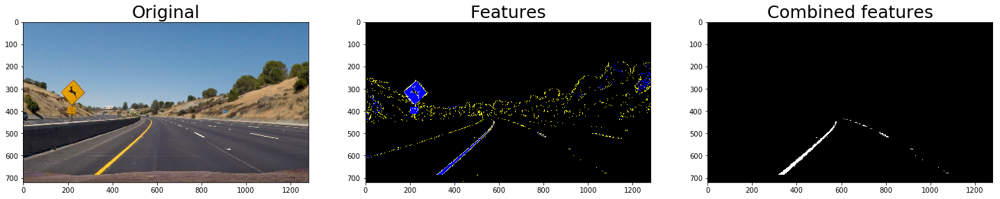

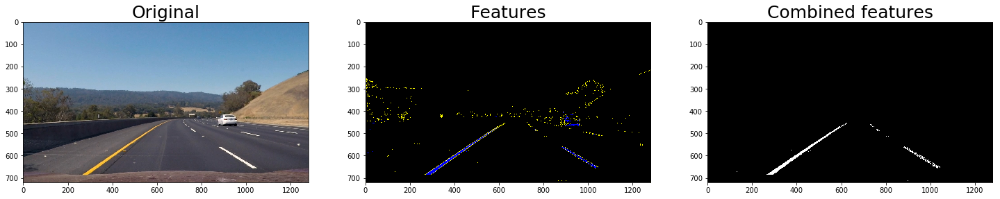

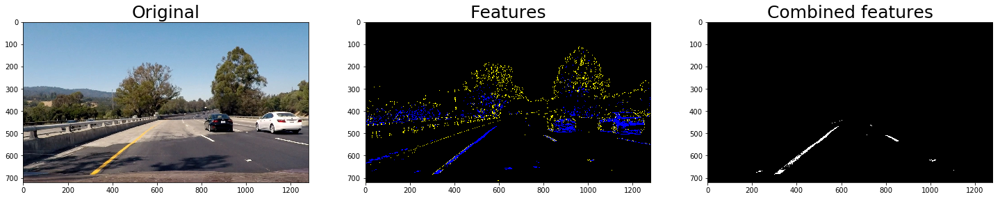

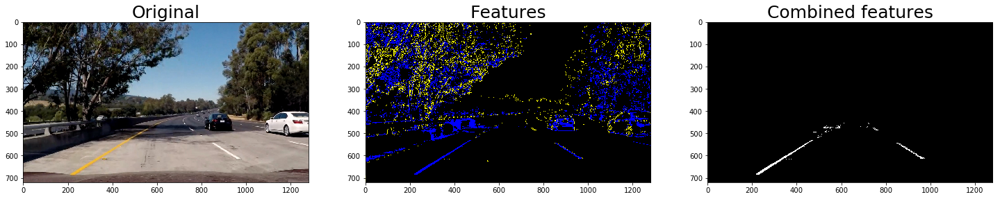

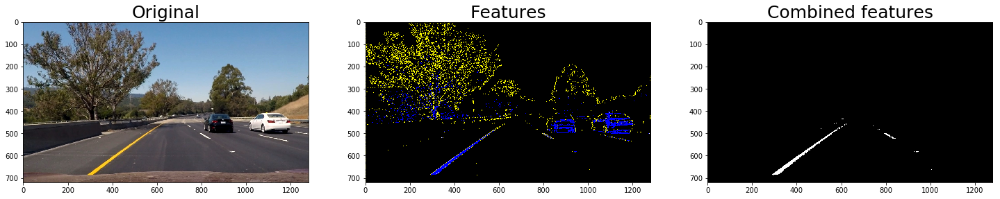

In [652]:
# extract features from example images
for fname in glob.glob('./test_images/*.jpg'):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    features_image, features_gray = extract_features(img)
    mask_away_noise(features_gray)
    figure = plt.figure(fname)
    
    _, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(features_image)
    ax2.set_title('Features', fontsize=25)
    ax3.imshow(features_gray, cmap='gray')
    ax3.set_title('Combined features', fontsize=25)

In [463]:
def perspective_transform(image, inverse=False):
    image_width = image.shape[1]
    image_height = image.shape[0]
    image_shape = (image_width, image_height)
    
    x_offset = int(image_width * 0.14)
    y_offset = int(image_height * 0.65)
    horizon_y = int(image_height * 0.7)
    horizon_x = int(image_width * 0.5)
    inward_x_shift = 1.2
    starting_pixels_from_center = 5
    ending_pixels_from_center = 16.5
    
    src = np.float32([
        [horizon_x - starting_pixels_from_center, horizon_y],
        [horizon_x + starting_pixels_from_center, horizon_y],
        [x_offset, image_height],
        [image_width - x_offset, image_height]
    ])
    
    dst = np.float32([
        [horizon_x - ending_pixels_from_center, y_offset],
        [horizon_x + ending_pixels_from_center, y_offset],
        [x_offset * inward_x_shift, image_height],
        [image_width - x_offset * inward_x_shift, image_height]
    ])
    
    #print(src, dst)
    
    # get the perspective transform matrix M
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    #transform perspective
    if inverse:
        warped = cv2.warpPerspective(image, Minv, image_shape)
    else:
        warped = cv2.warpPerspective(image, M, image_shape)
    
    return warped

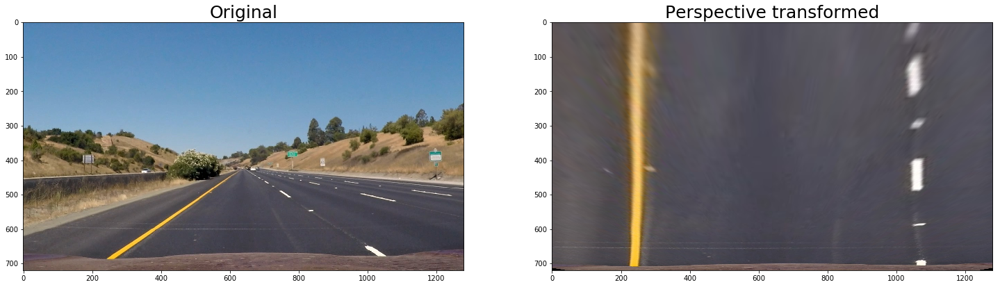

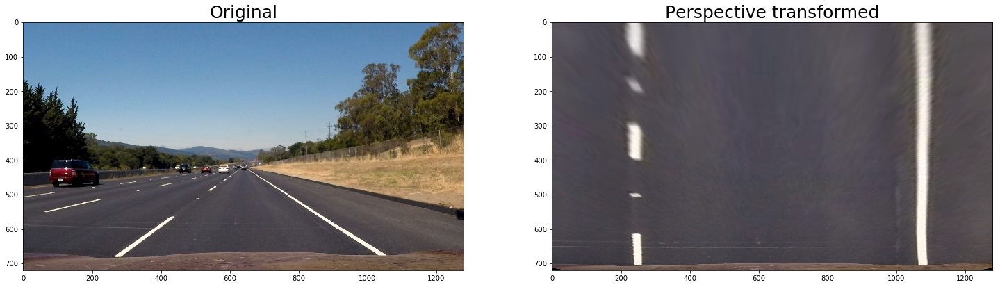

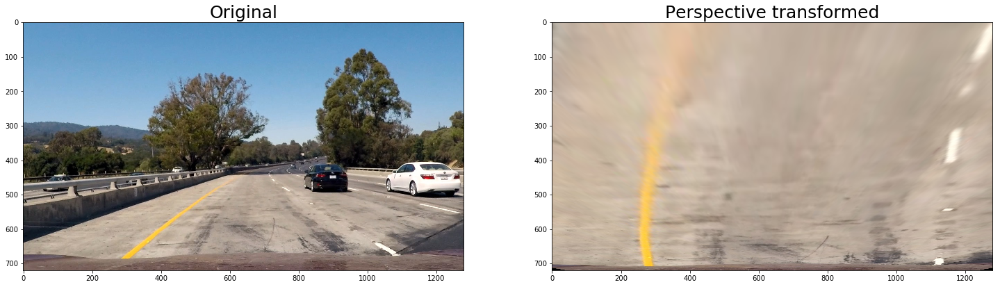

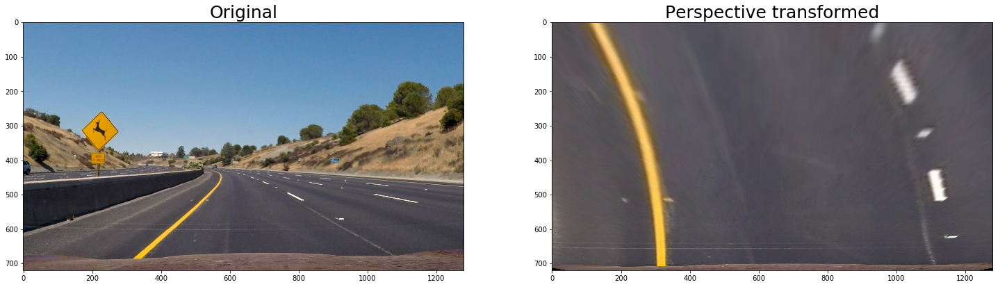

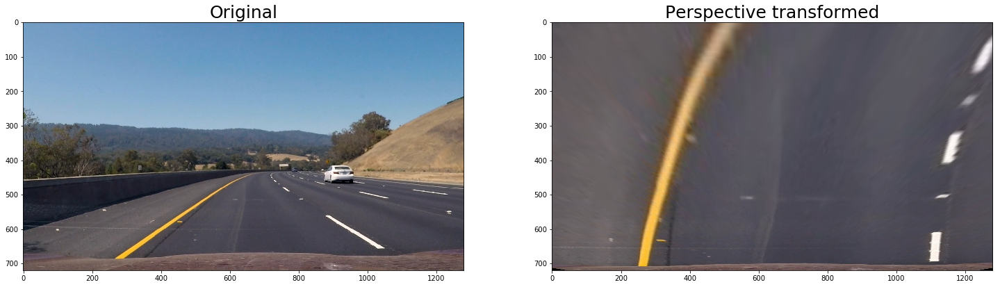

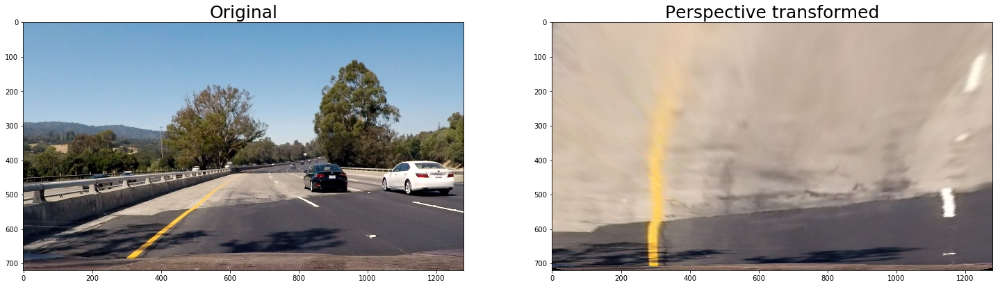

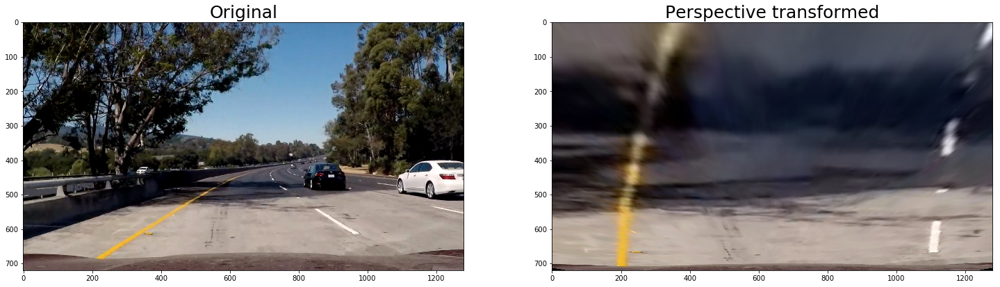

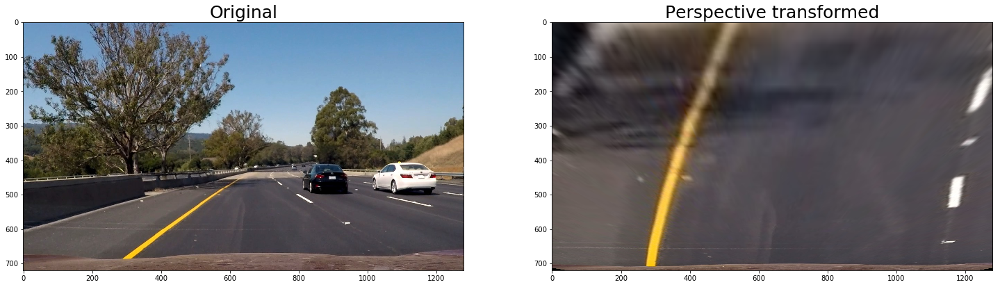

In [464]:
# transform perspective from example images
for fname in glob.glob('./test_images/*.jpg'):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    warped = perspective_transform(img)
    
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(warped)
    ax2.set_title('Perspective transformed', fontsize=25)

In [545]:
def image_pipeline(image):
    img = undistort(image, calibration_mtx, calibration_dist)
    _, features = extract_features(img)
    mask_away_noise(features)
    warped = perspective_transform(features)
    
    return warped

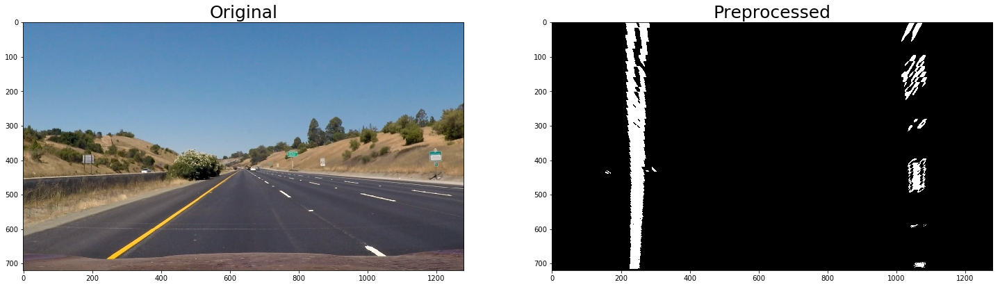

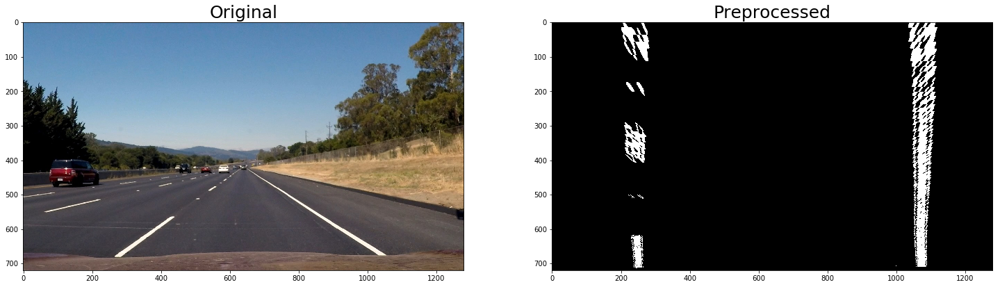

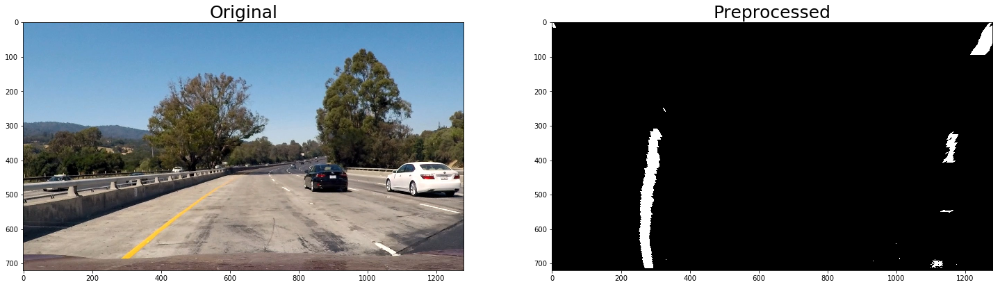

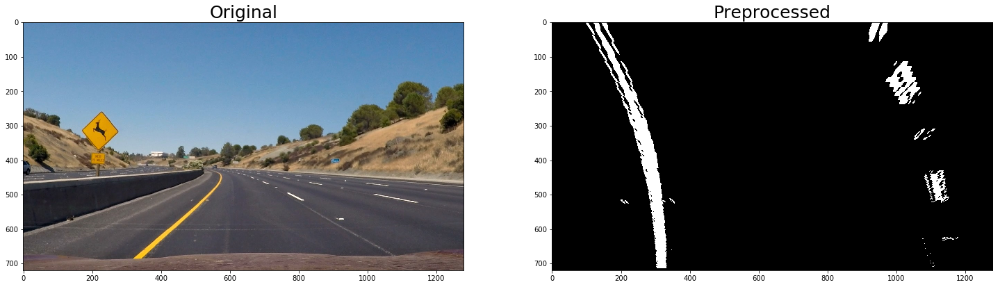

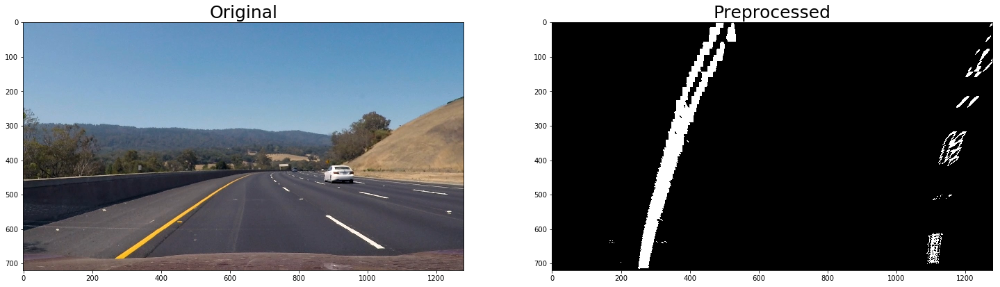

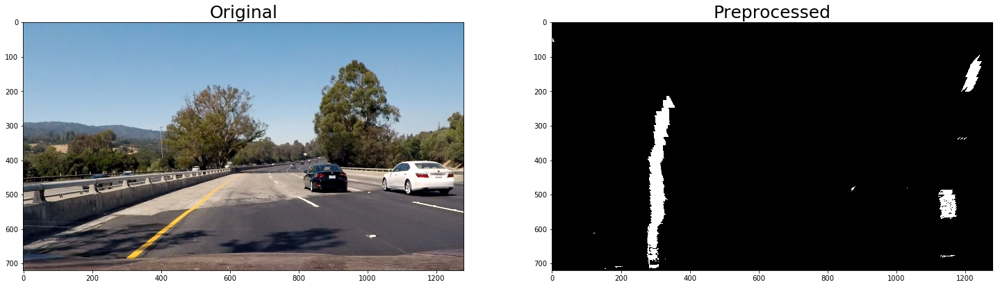

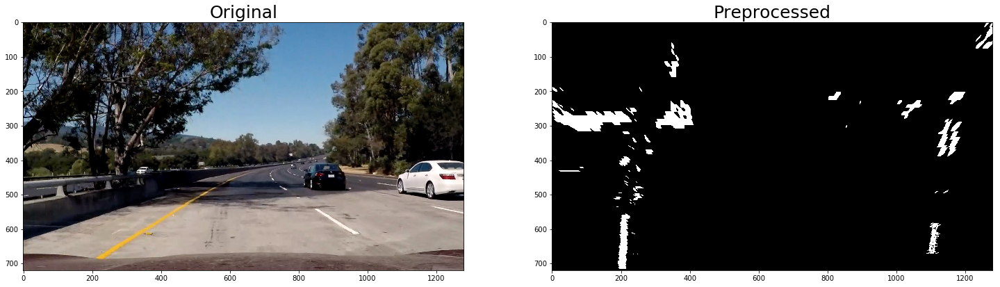

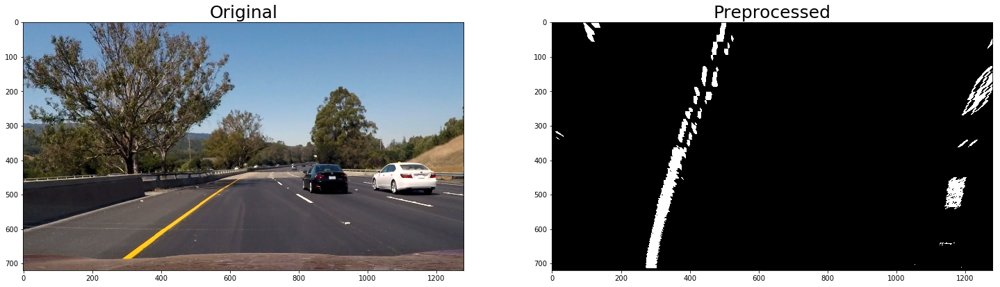

In [627]:
# apply all transformations
for fname in glob.glob('./test_images/*.jpg'):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    preprocessed = image_pipeline(img)
    
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(preprocessed, cmap='gray')
    ax2.set_title('Preprocessed', fontsize=25)

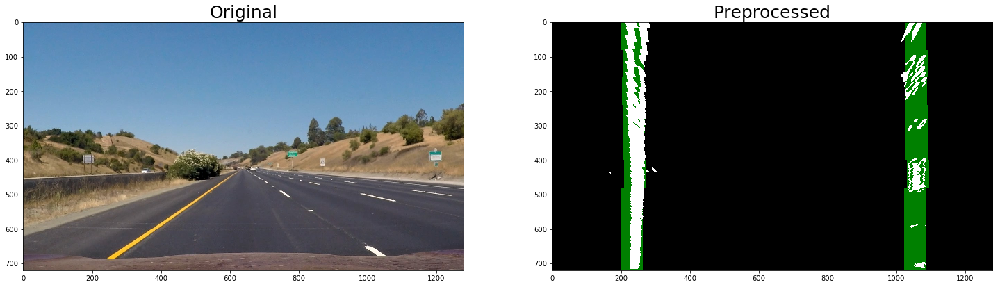

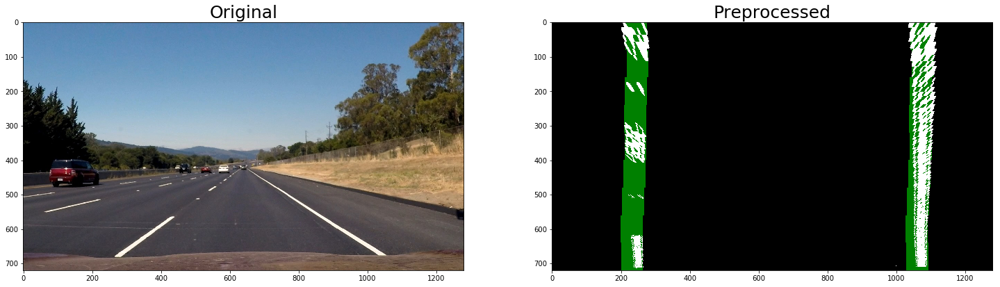

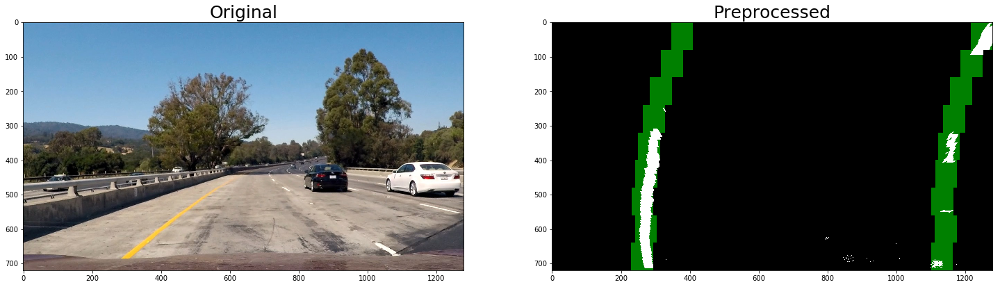

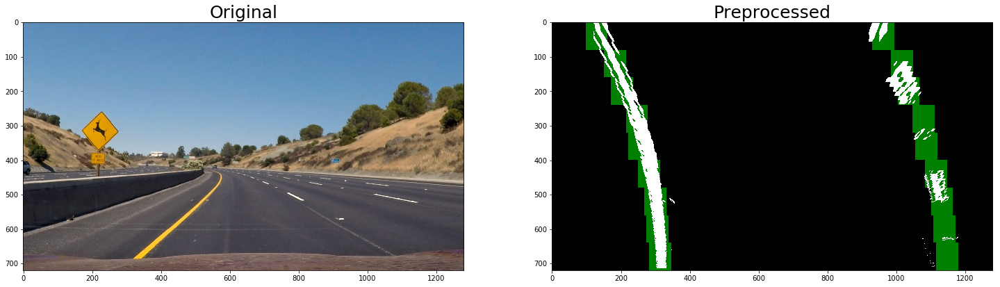

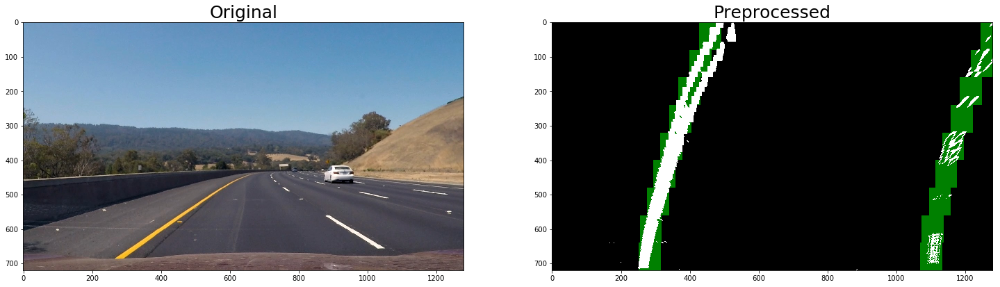

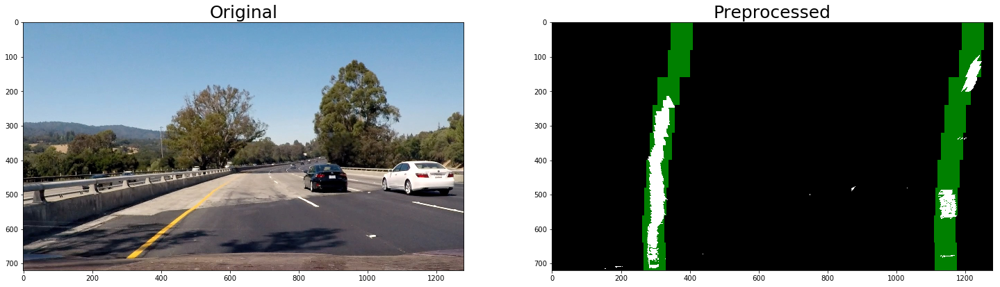

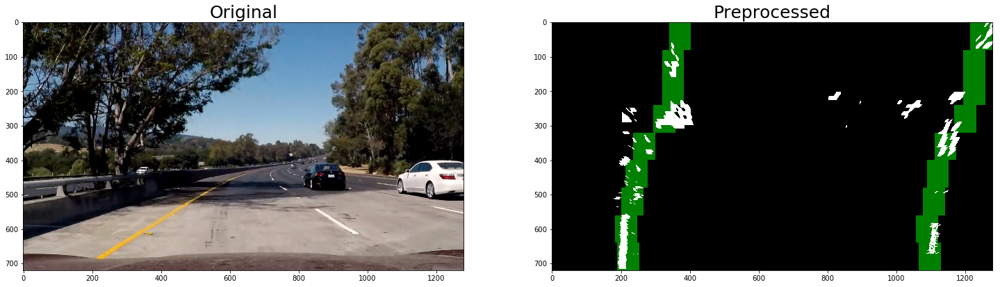

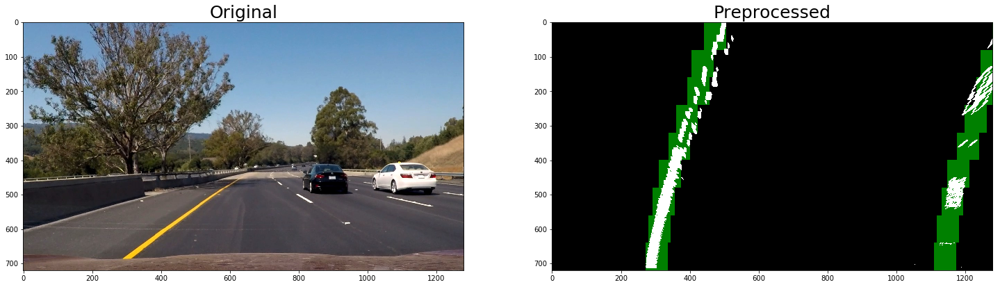

In [717]:
# function to extract centers of lines
def find_window_centroids(image, window_width, window_height, margin):
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # Sum slices of image
    ratio_denominator = 4
    image_width = image.shape[1]
    l_sum = np.sum(image[int((ratio_denominator - 1) * image.shape[0] / ratio_denominator):, :int(image_width * 0.4)], axis=0)
    l_center = np.argmax(np.convolve(window, l_sum)) - (window_width / 2)
    r_sum = np.sum(image[int((ratio_denominator - 1) * image.shape[0] / ratio_denominator):, int(image_width * 0.6):], axis=0)
    r_center = np.argmax(np.convolve(window, r_sum)) + (image_width * 0.6) - (window_width / 2)
    
    width = r_center - l_center
    #center = np.mean([r_center, l_center])
    
    # Add what we found for the first layer
    y = image.shape[0] - window_height / 2
    window_centroids.append(((l_center, y), (r_center, y)))
    
    # Go through each layer looking for max pixel locations
    level_count = (int)(image.shape[0] / window_height)
    for level in range(1, level_count):
        # convolve the window into the vertical slice of the image
        y_min = int(image.shape[0] - (level + 1) * window_height)
        y_max = int(image.shape[0] - level * window_height)
        
        # black out everything outside of reasonable boundaries
        last_l_min = window_centroids[-1][0][0] - window_width
        last_r_max = window_centroids[-1][1][0] + window_width
        image[y_min:y_max, 0:max(int(last_l_min), 0)] = 0
        image[y_min:y_max, min(int(last_r_max), image_width):image_width] = 0
        
        image_layer = np.sum(
            image[y_min:y_max, :],
            axis=0)

        
        conv_signal = np.convolve(window, image_layer)
        
        # Use window_width/2 as offset because convolution signal reference is at right side of window,
        # not center of window
        # reduce confidence at distance from vehicle
        offset = window_width / 2
        
        # Find the best left centroid by using past left center as a reference
        l_min_index = int(max(l_center + offset - margin, 0))
        l_max_index = int(min(l_center + offset + margin, image.shape[1]))
        if l_max_index > l_min_index:
            conv_range = conv_signal[l_min_index:l_max_index]
            if max(conv_range) > 50:
                l_center = np.argmax(conv_range) + l_min_index - offset
            else:
                l_center = (l_min_index + l_max_index) / 2
        else:
            l_center = l_min_index
        
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center + offset - margin, 0))
        r_max_index = int(min(r_center + offset + margin, image.shape[1]))
        if r_max_index > r_min_index:
            conv_range = conv_signal[r_min_index:r_max_index]
            if max(conv_range) > 50:
                r_center = np.argmax(conv_range) + r_min_index - offset
            else:
                r_center = (r_min_index + r_max_index) / 2
        else:
            r_center = r_min_index
        
        # sanity check for further-forward data. If the line suddenly changes directions,
        # suspect trouble
        if level > level_count * 0.6:
            l_diffs = []
            r_diffs = []
            for past_level in range(len(window_centroids) - 1):
                start_level = window_centroids[past_level]
                next_level = window_centroids[past_level + 1]
                l_diff = next_level[0][0] - start_level[0][0]
                r_diff = next_level[1][0] - start_level[1][0]
                l_diffs.append(l_diff)
                r_diffs.append(r_diff)
            
            l_diff_sum = np.sum(l_diffs)
            r_diff_sum = np.sum(r_diffs)
            
            current_l_diff = l_center - window_centroids[-1][0][0]
            current_r_diff = r_center - window_centroids[-1][1][0]
            
            l_diff_deviated = (((current_l_diff > 0 and l_diff_sum < 0) or
                (current_l_diff < 0 and l_diff_sum > 0)) and
                np.abs(current_l_diff) > 20)
                
            r_diff_deviated = (((current_r_diff > 0 and r_diff_sum < 0) or
                (current_r_diff < 0 and r_diff_sum > 0)) and
                np.abs(current_r_diff) > 20)
                
            if l_diff_deviated:
                l_center = (window_centroids[-1][0][0] +
                    (window_centroids[-1][0][0] - window_centroids[0][0][0]) / (level - 1))
                
            if r_diff_deviated:
                r_center = (window_centroids[-1][1][0] +
                    (window_centroids[-1][1][0] - window_centroids[3][1][0]) / (level - 1))
                
        
        # force equal lane width / parallel lanes
        new_center = np.mean([l_center, r_center])
        l_center = new_center - (width / 2)
        r_center = new_center + (width / 2)
                
        
        # Add what we found for that layer
        y = image.shape[0] - window_height / 2 - level * window_height
        window_centroids.append(((l_center, y), (r_center, y)))

    return window_centroids

# window settings
image_size = (720, 1280)
window_width = image_size[1] // 20
window_height = image_size[0] // 9 # Break image into 9 vertical layers since image height is 720
margin = window_width * 2 # How much to slide left and right for searching

# functions to visualize windows
def window_mask(width, height, img_ref, center):
    output = np.zeros_like(img_ref)
    
    x = center[0]
    y = center[1]
    
    bottom_y = int(y + height / 2)
    top_y = int(max(y - height / 2, 0))
    left_x = max(0, int(x - width / 2))
    right_x = max(min(int(x + width / 2), img_ref.shape[1]), 0)
    
    output[top_y:bottom_y, left_x:right_x] = 1
    return output

def draw_centroids(img, centroids):
    # Points used to draw all the left and right windows
    l_points = np.zeros_like(img)
    r_points = np.zeros_like(img)

    # Go through each level and draw the windows
    for level in range(0, len(centroids)):
        # Window_mask is a function to draw window areas
        l_mask = window_mask(window_width, window_height, img, centroids[level][0])
        r_mask = window_mask(window_width, window_height, img, centroids[level][1])
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 1.) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 1.) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points + l_points, np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8) # make window pixels green
    warpage = np.array(cv2.merge((img, img, img)), np.uint8) * 255 # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the original road image with window results
    
    return output

count = 0
for fname in glob.glob('./test_images/*.jpg'):
    count += 1
    #if count != 3: # select an individual image
    #    continue
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    preprocessed = image_pipeline(img)
    window_centroids = find_window_centroids(preprocessed, window_width, window_height, margin)
    processed = draw_centroids(preprocessed, window_centroids)
    
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(processed, cmap='gray')
    ax2.set_title('Preprocessed', fontsize=25)


In [324]:
# Fit a second order polynomial to the passed-in centroids
def find_curve(points, x_scale=1, y_scale=1):
    #extract x and y from points
    xs = [point[0] * x_scale for point in points]
    ys = [point[1] * y_scale for point in points]
    
    # y as a function of x, which makes plotting easier
    return np.polyfit(ys, xs, 2)

In [325]:
def find_curves(centroids, x_scale=1, y_scale=1):
    left_points = [centroid[0] for centroid in centroids]
    right_points = [centroid[1] for centroid in centroids]
    
    left_curve = find_curve(left_points, x_scale, y_scale)
    right_curve = find_curve(right_points, x_scale, y_scale)
    
    #print(left_curve, right_curve)
    
    return left_curve, right_curve

In [634]:
def evaluate_curve_function(value, curve):
    return curve[0] * value**2 + curve[1] * value + curve[2]

# overlay an image on another
def weighted_img(img, initial_img, α=0.98, β=1., λ=0.):
    """
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

def plot_curves(img, curves):
    height = img.shape[0]
    width = img.shape[1]
    left_curve, right_curve = curves
    y_coordinates = np.linspace(0, height - 1, num=height)
    
    left_x_coordinates = [evaluate_curve_function(y, left_curve) for y in y_coordinates]
    right_x_coordinates = [evaluate_curve_function(y, right_curve) for y in y_coordinates]
    
    x_ranges = [sorted(item) for item in zip(left_x_coordinates, right_x_coordinates)]
    
    overlay = np.zeros_like(img)
    for y in range(height):
        left_x = int(np.round(left_x_coordinates[y]))
        right_x = int(np.round(right_x_coordinates[y]))
        if left_x >= 0 and left_x < width:
            overlay[y, max(left_x, 0):max(left_x + 20, 0), 0] = 255 # left red line
        if right_x >= 0 and right_x < width:
            overlay[y, min(right_x - 20, width):min(right_x, width), 0] = 255 # right red line
        
        if left_x < width and right_x > 0:
            overlay[y, max(left_x, 0):min(right_x, width), 1] = 255 # center green field
        
    return overlay # weighted_img(overlay, img)

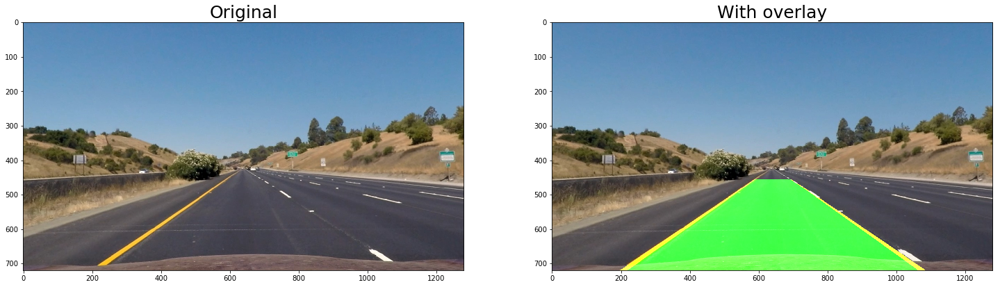

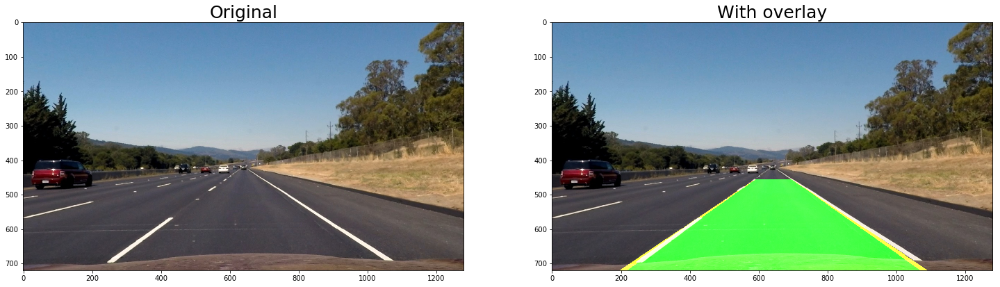

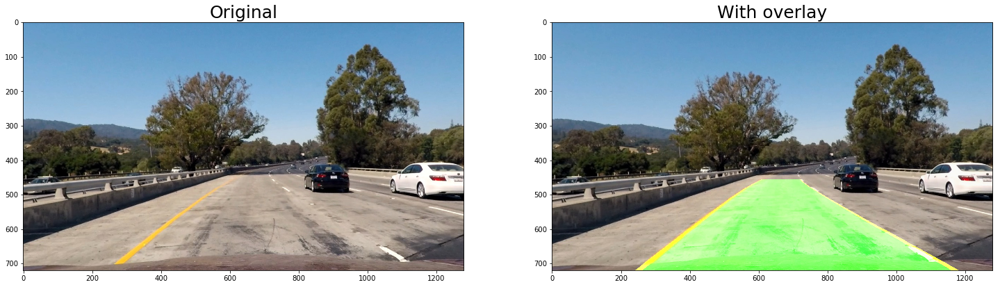

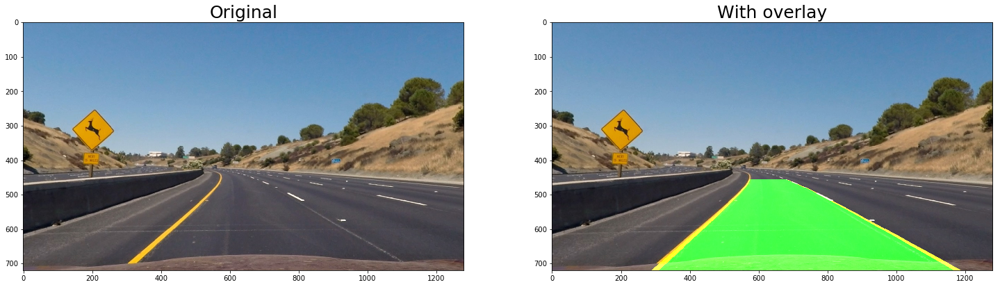

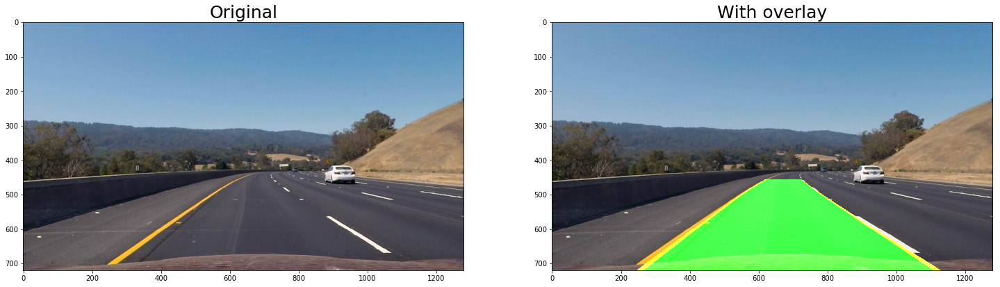

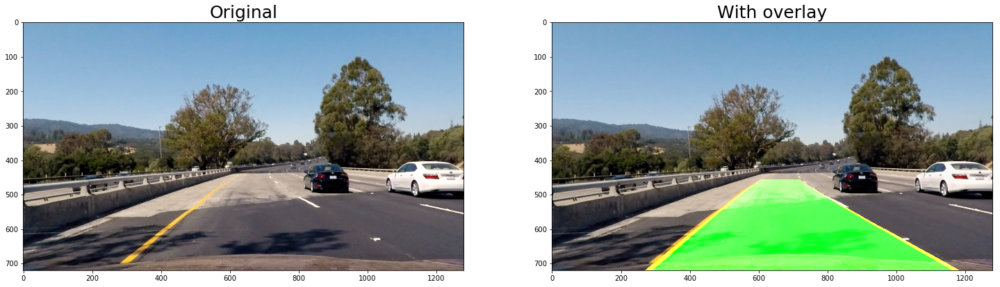

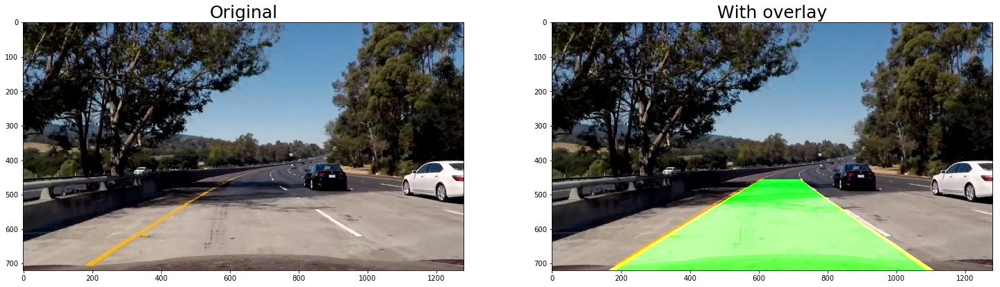

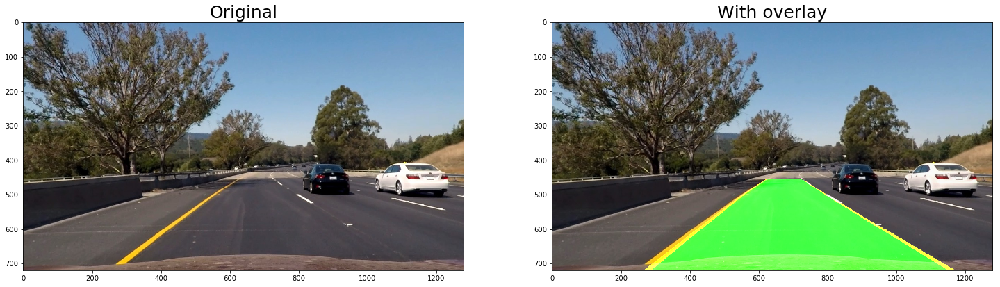

In [718]:
for fname in glob.glob('./test_images/*.jpg'):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #preprocessed = image_pipeline(img)
    img = undistort(img, calibration_mtx, calibration_dist)
    _, features = extract_features(img)
    mask_away_noise(features)
    preprocessed = perspective_transform(features)
    
    window_centroids = find_window_centroids(preprocessed, window_width, window_height, margin)
    
    curves = find_curves(window_centroids)
    
    overlay = plot_curves(img, curves)
    overlay = perspective_transform(overlay, True)
    
    combined = weighted_img(overlay, img)
    
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,10))
    ax1.imshow(img)
    ax1.set_title('Original', fontsize=25)
    ax2.imshow(combined)
    ax2.set_title('With overlay', fontsize=25)

In [638]:
# struct-type object to hold details about curve
class Curve():
    def __init__(self):
        # was the line detected in the last iteration?
        self.steps_since_detected = 0
        
        # polynomial coefficients for the curve
        self.coefficients = []
        
        self.radius_of_curvature = 0
        
        # distance in meters of vehicle center from the line
        self.line_base_pos = None
        
        self.centroids = None

In [741]:
left_curve = Curve()
right_curve = Curve()
past_weight = 0.8

def get_curve_radius(coefficients, scale):
    max_y = 720 - 1
    return ((1 + (2 * coefficients[0] * max_y * scale + coefficients[1])**2)**1.5) / np.absolute(2 * coefficients[0])

def get_curve_radii(centroids):
    # Define conversions in x and y from pixels space to meters (very approximate)
    ym_per_pix = 30 / 850 # meters per pixel in y dimension
    xm_per_pix = 3.7 / 850 # meters per pixel in x dimension
    
    coefficients = find_curves(centroids, xm_per_pix, ym_per_pix)
    
    left_radius = get_curve_radius(coefficients[0], ym_per_pix)
    right_radius = get_curve_radius(coefficients[1], ym_per_pix)

    return left_radius, right_radius

def get_distances_from_center(coefficients):
    left_coefficients, right_coefficients = coefficients
    max_y = 720 - 1
    
    left_center = evaluate_curve_function(max_y, left_coefficients)
    right_center = evaluate_curve_function(max_y, right_coefficients)
    
    xm_per_pixel = 3.7 / 850 # this is approximate, and calculated sort of empirically
    
    x_center = 1280 / 2
    
    left_pixel_distance = x_center - left_center
    right_pixel_distance = right_center - x_center
    
    left_meter_distance = left_pixel_distance * xm_per_pixel
    right_meter_distance = right_pixel_distance * xm_per_pixel
    
    return left_meter_distance, right_meter_distance

def save_curve(curve, coefficients, radius, distance, centroids):
    # anything below 600 is not a regulation road
    # and too much deviation means the data is bad
    """if radius < 600 or (curve.radius_of_curvature != 0 and np.absolute(curve.radius_of_curvature - radius) > 700):
        curve.steps_since_detected += 1
        #print('leaving!')
        return curve"""
    
    # deviation from the previous lane distance seems like a better check
    if curve.line_base_pos and np.abs(curve.line_base_pos - distance) > 0.5:
        curve.steps_since_detected += 1
        return curve
    
    curve.steps_since_detected = 0
    
    if len(curve.coefficients) == 0:
        curve.coefficients = coefficients
    else:
        curve.coefficients = curve.coefficients * past_weight + (1 - past_weight) * coefficients
        
    if curve.radius_of_curvature == 0:
        curve.radius_of_curvature = radius
    else:
        curve.radius_of_curvature = curve.radius_of_curvature * past_weight + (1 - past_weight) * radius
    
    if not curve.line_base_pos:
        curve.line_base_pos = distance
    else:
        curve.line_base_pos = curve.line_base_pos * past_weight + (1 - past_weight) * distance

    return curve
        
def save_curves(coefficients, radii, distances, centroids):
    global left_curve
    global right_curve
    left_curve = save_curve(left_curve, coefficients[0], radii[0], distances[0], centroids[0])
    right_curve = save_curve(right_curve, coefficients[1], radii[1], distances[1], centroids[1])

def process_image(img):
    img = undistort(img, calibration_mtx, calibration_dist)
    _, features = extract_features(img)
    features = mask_away_noise(features)
    preprocessed = perspective_transform(features)
    window_centroids = find_window_centroids(preprocessed, window_width, window_height, margin)
    
    coefficients = find_curves(window_centroids)
    radii = get_curve_radii(window_centroids)
    distances = get_distances_from_center(coefficients)
    save_curves(coefficients, radii, distances, window_centroids)
    
    overlay = plot_curves(img, (left_curve.coefficients, right_curve.coefficients))
    overlay = perspective_transform(overlay, True)
    
    combined = weighted_img(overlay, img)
    # to visualize the preprocessed data, use these lines instead of the above line
    #three_channel_preprocessed = np.array(cv2.merge((preprocessed, preprocessed, preprocessed)), np.uint8) * 255
    #combined = weighted_img(three_channel_preprocessed, img, α=0.5)
    
    left_lane_text = "Left: radius {}, distance {}".format(
        np.round(left_curve.radius_of_curvature, 2),
        np.round(left_curve.line_base_pos, 2)
    )
    right_lane_text = "Right: radius {}, distance {}".format(
        np.round(right_curve.radius_of_curvature, 2),
        np.round(right_curve.line_base_pos, 2)
    )
    cv2.putText(combined, left_lane_text, (20, 35), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 100, 100), 3)
    cv2.putText(combined, right_lane_text, (20, 65), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 100, 100), 3)
    
    return combined

In [739]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# process video
previous_curves = []
video_output = './project_video_output.mp4'
clip = VideoFileClip("./project_video.mp4")
processed_clip = clip.fl_image(process_image) #.subclip(0, 0.5) # a subclip can be used for quick testing

%time processed_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video ./project_video_output.mp4
[MoviePy] Writing video ./project_video_output.mp4


100%|█████████▉| 1260/1261 [45:57<00:02,  2.62s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_output.mp4 

CPU times: user 47min 12s, sys: 1min 11s, total: 48min 23s
Wall time: 45min 59s


In [740]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

In [729]:
# challenge video
previous_curves = []
video_output = './challenge_video_output.mp4'
clip = VideoFileClip("./challenge_video.mp4")
processed_clip = clip.fl_image(process_image)

%time processed_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video ./challenge_video_output.mp4
[MoviePy] Writing video ./challenge_video_output.mp4


100%|██████████| 485/485 [17:14<00:00,  2.13s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./challenge_video_output.mp4 

CPU times: user 17min 52s, sys: 28.7 s, total: 18min 21s
Wall time: 17min 16s


In [730]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

In [744]:
# harder challenge video
previous_curves = []
video_output = './harder_challenge_video_output.mp4'
clip = VideoFileClip("./harder_challenge_video.mp4")
processed_clip = clip.fl_image(process_image)

%time processed_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video ./harder_challenge_video_output.mp4
[MoviePy] Writing video ./harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [44:11<00:02,  2.15s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./harder_challenge_video_output.mp4 

CPU times: user 45min 29s, sys: 1min 7s, total: 46min 37s
Wall time: 44min 14s


In [745]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))